In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import numpy as np

In [42]:
df = pd.read_csv('../realtor-data.csv')

In [4]:
df.shape

(1048575, 12)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 12 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   brokered_by     1047537 non-null  float64
 1   status          1048575 non-null  object 
 2   price           1047485 non-null  float64
 3   bed             738569 non-null   float64
 4   bath            723607 non-null   float64
 5   acre_lot        870247 non-null   float64
 6   street          1041799 non-null  float64
 7   city            1047715 non-null  object 
 8   state           1048568 non-null  object 
 9   zip_code        1048416 non-null  float64
 10  house_size      683689 non-null   float64
 11  prev_sold_date  497886 non-null   object 
dtypes: float64(8), object(4)
memory usage: 96.0+ MB


In [6]:
df.describe()

,brokered_by,price,bed,bath,acre_lot,street,zip_code,house_size
count,1.047537e+06,1.047485e+06,738569.000000,723607.000000,870247.000000,1.041799e+06,1.048416e+06,6.836890e+05
mean,5.187727e+04,4.774979e+05,3.309546,2.536147,15.345766,1.055064e+06,3.790441e+04,2.137796e+03
std,3.039121e+04,2.774217e+06,1.598269,1.675857,747.421182,6.057396e+05,1.965920e+04,1.249966e+04
min,0.000000e+00,0.000000e+00,1.000000,1.000000,0.000000,3.000000e+00,0.000000e+00,4.000000e+00
25%,2.371300e+04,1.200000e+05,3.000000,2.000000,0.180000,5.309800e+05,2.500500e+04,1.312000e+03
50%,5.263300e+04,2.760000e+05,3.000000,2.000000,0.360000,1.064730e+06,3.395000e+04,1.800000e+03
75%,7.883800e+04,4.820000e+05,4.000000,3.000000,1.300000,1.599512e+06,5.322200e+04,2.500000e+03
max,1.101420e+05,2.147484e+09,473.000000,752.000000,100000.000000,2.001357e+06,9.999900e+04,9.842382e+06


In [7]:
df.head(8)

,brokered_by,status,price,bed,bath,acre_lot,street,city,state,zip_code,house_size,prev_sold_date
0,103378.0,for_sale,105000.0,3.0,2.0,0.12,1962661.0,Adjuntas,Puerto Rico,601.0,920.0,NaN
1,52707.0,for_sale,80000.0,4.0,2.0,0.08,1902874.0,Adjuntas,Puerto Rico,601.0,1527.0,NaN
2,103379.0,for_sale,67000.0,2.0,1.0,0.15,1404990.0,Juana Diaz,Puerto Rico,795.0,748.0,NaN
3,31239.0,for_sale,145000.0,4.0,2.0,0.10,1947675.0,Ponce,Puerto Rico,731.0,1800.0,NaN
4,34632.0,for_sale,65000.0,6.0,2.0,0.05,331151.0,Mayaguez,Puerto Rico,680.0,NaN,NaN
5,103378.0,for_sale,179000.0,4.0,3.0,0.46,1850806.0,San Sebastian,Puerto Rico,612.0,2520.0,NaN
6,1205.0,for_sale,50000.0,3.0,1.0,0.20,1298094.0,Ciales,Puerto Rico,639.0,2040.0,NaN
7,50739.0,for_sale,71600.0,3.0,2.0,0.08,1048466.0,Ponce,Puerto Rico,731.0,1050.0,NaN


In [8]:
df.tail(8)

,brokered_by,status,price,bed,bath,acre_lot,street,city,state,zip_code,house_size,prev_sold_date
1048567,53016.0,for_sale,511400.0,NaN,NaN,12.79,313693.0,Harker Heights,Texas,76548.0,NaN,NaN
1048568,3873.0,for_sale,508620.0,4.0,3.0,0.39,812581.0,Harker Heights,Texas,76548.0,2595.0,NaN
1048569,3873.0,for_sale,523171.0,4.0,3.0,0.40,828186.0,Harker Heights,Texas,76548.0,2629.0,NaN
1048570,68915.0,for_sale,467847.0,5.0,4.0,0.19,773587.0,Harker Heights,Texas,76548.0,3499.0,NaN
1048571,68915.0,for_sale,345249.0,5.0,3.0,0.19,772323.0,Harker Heights,Texas,76548.0,2572.0,NaN
1048572,61150.0,for_sale,325000.0,NaN,NaN,0.68,1024251.0,Harker Heights,Texas,76548.0,NaN,NaN
1048573,68915.0,for_sale,456122.0,5.0,4.0,0.19,273557.0,Harker Heights,Texas,76548.0,3499.0,NaN
1048574,61150.0,for_sale,325000.0,NaN,NaN,0.69,1024490.0,Harker Heights,Texas,76548.0,NaN,NaN


Data Cleanning 

In [9]:
df.duplicated().sum()

np.int64(0)

In [10]:
df.drop_duplicates(inplace=True)

In [11]:
total_missing = df.isna().sum()*100/len(df)
print('Percentage Missing Value %')
total_missing

Percentage Missing Value %


brokered_by        0.098991
status             0.000000
price              0.103951
bed               29.564504
bath              30.991393
acre_lot          17.006700
street             0.646210
city               0.082016
state              0.000668
zip_code           0.015163
house_size        34.798274
prev_sold_date    52.517846
dtype: float64

In [12]:
df = df.dropna(subset=['zip_code','city'])
df = df.drop('prev_sold_date', axis=1)

In [13]:
# Mode imputation to handle missing value
df['bed'].fillna(df['bed'].mode()[0], inplace=True)
df['acre_lot'].fillna(df['acre_lot'].mode()[0], inplace=True)

C:\Users\OEM\AppData\Local\Temp\ipykernel_14072\1462640070.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['bed'].fillna(df['bed'].mode()[0], inplace=True)
C:\Users\OEM\AppData\Local\Temp\ipykernel_14072\1462640070.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For exam

In [14]:
# Drop these to handle missing value
df.dropna(subset=['bath', 'house_size', 'price'], inplace=True)
df.drop(df[(df['bath'] == 0) | (df['house_size'] == 0) |(df['bath'] == 0)].index, inplace=True)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 658889 entries, 0 to 1048573
Data columns (total 11 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   brokered_by  658286 non-null  float64
 1   status       658889 non-null  object 
 2   price        658889 non-null  float64
 3   bed          658889 non-null  float64
 4   bath         658889 non-null  float64
 5   acre_lot     658889 non-null  float64
 6   street       655517 non-null  float64
 7   city         658889 non-null  object 
 8   state        658889 non-null  object 
 9   zip_code     658889 non-null  float64
 10  house_size   658889 non-null  float64
dtypes: float64(8), object(3)
memory usage: 60.3+ MB


In [16]:
df.isnull().sum()

brokered_by     603
status            0
price             0
bed               0
bath              0
acre_lot          0
street         3372
city              0
state             0
zip_code          0
house_size        0
dtype: int64

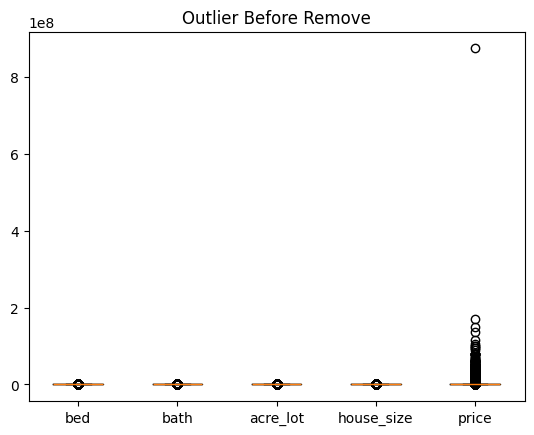

Total Row With Outlier: 658889


In [17]:
column_num = ['bed','bath','acre_lot','house_size','price']
plt.boxplot(df[column_num])
plt.xticks([1, 2, 3, 4, 5], column_num)
plt.title('Outlier Before Remove')
plt.show()
print(f'Total Row With Outlier: {df.shape[0]}')

In [18]:
Q1 = df[column_num].quantile(0.25)
Q3 = df[column_num].quantile(0.75)
IQR = Q3 - Q1

df = df[~((df[column_num] < (Q1 - 1.5 * IQR)) | (df[column_num] > (Q3 + 1.5 * IQR))).any(axis=1)]

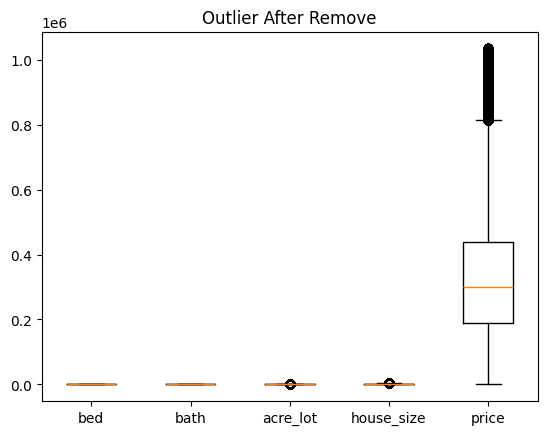

Total Row Without Outlier: 469233


In [19]:
column_num = ['bed','bath','acre_lot','house_size','price']
plt.boxplot(df[column_num])
plt.xticks([1, 2, 3, 4, 5], column_num)
plt.title('Outlier After Remove')
plt.show()
print(f'Total Row Without Outlier: {df.shape[0]}')

In [20]:
df.describe()

,brokered_by,price,bed,bath,acre_lot,street,zip_code,house_size
count,468789.000000,4.692330e+05,469233.000000,469233.000000,469233.000000,4.671060e+05,469233.000000,469233.000000
mean,52050.213851,3.371289e+05,3.149889,2.294372,0.245000,9.311767e+05,39209.353694,1794.762941
std,29860.166808,1.977145e+05,0.807541,0.820956,0.154959,5.383126e+05,19470.936984,688.881922
min,0.000000,0.000000e+00,2.000000,1.000000,0.000000,6.300000e+01,601.000000,100.000000
25%,25764.000000,1.899000e+05,3.000000,2.000000,0.150000,4.651168e+05,27858.000000,1275.000000
50%,52707.000000,3.000000e+05,3.000000,2.000000,0.230000,9.393795e+05,34209.000000,1674.000000
75%,78689.000000,4.399000e+05,4.000000,3.000000,0.270000,1.392304e+06,55116.000000,2196.000000
max,110142.000000,1.035500e+06,5.000000,4.000000,0.890000,2.001321e+06,95000.000000,4257.000000


# Exploratory Data Analysis (EDA)

### Heatmap of all variables

This visualization shows the correlation between variables. When the result is positive, it means it is correlate with that variable

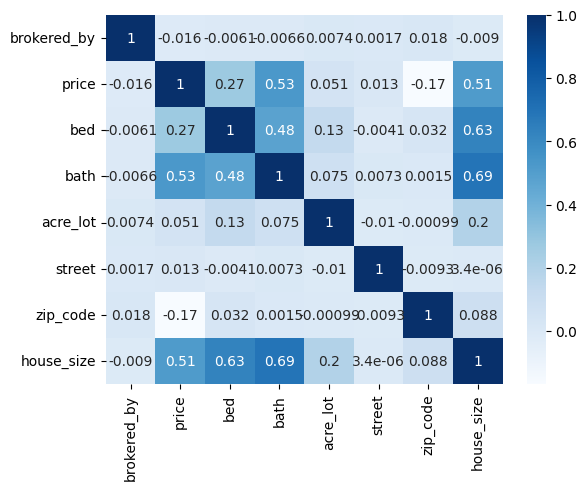

In [21]:
#correlation between variables 
# sns.heatmap(df.corr(),annot=True, cmap= 'Blues')
# Exclude non-numeric columns from the correlation calculation
numeric_df = df.select_dtypes(include=['float64', 'int64'])

# Create the heatmap using the correlation matrix of the numeric DataFrame
sns.heatmap(numeric_df.corr(), annot=True, cmap='Blues')
plt.show()


### Top 10 Average House Prices by State

---

It presents the top 10 states with the highest average house prices into regional variations in housing market prices.

C:\Users\OEM\AppData\Local\Temp\ipykernel_14072\3889727437.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=average_price_by_state.index, y=average_price_by_state.values, palette=cols)


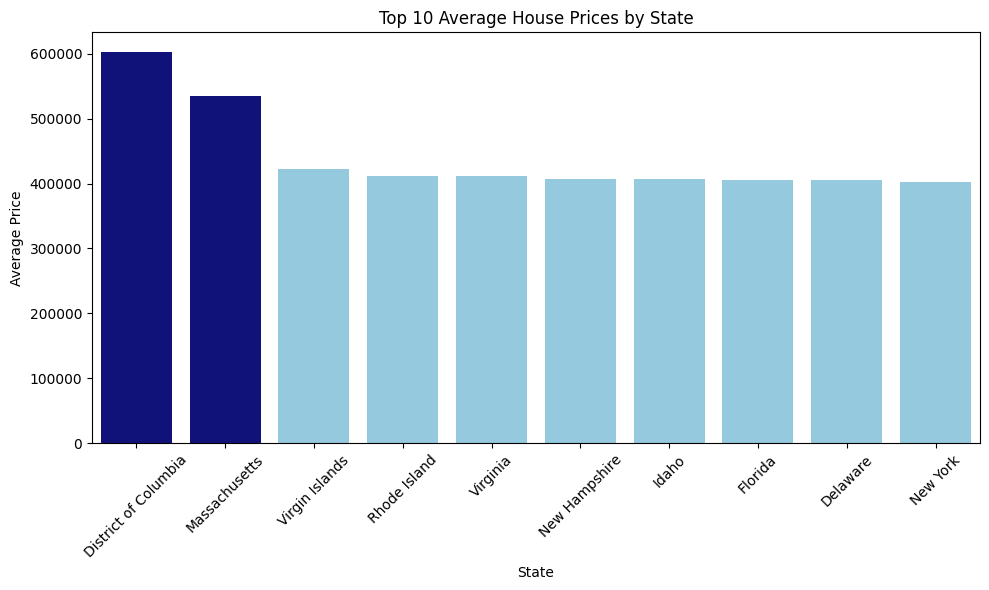

In [22]:
# Calculate average price by state
average_price_by_state = df.groupby('state')['price'].mean().sort_values(ascending=False).head(10)

# Plotting
plt.figure(figsize=(10, 6))
cols = ['skyblue' if x<450000 else 'darkblue' for x in average_price_by_state.values]
sns.barplot(x=average_price_by_state.index, y=average_price_by_state.values, palette=cols)
plt.title('Top 10 Average House Prices by State')
plt.xlabel('State')
plt.ylabel('Average Price')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### Geographical Representation of Average House Prices in USA


---

It visually represents the geographical distribution of average house prices across the USA, offering a spatial understanding of housing market trends and variations.

In [23]:
%pip install geopy
%pip install folium


Note: you may need to restart the kernel to use updated packages.


In [24]:
import folium
from geopy.geocoders import Nominatim
from folium.plugins import MarkerCluster
us_map = folium.Map(location=[37.0902, -95.7129], zoom_start=4)
geolocator = Nominatim(user_agent="my_geocoder")

In [25]:
# Calculate average price per state
avg_price_per_state = df.groupby('state')['price'].mean().reset_index()

# Define marker colors based on price levels
def get_marker_color(price):
    if price <= 250000:
        return 'blue'
    elif price <= 450000:
        return 'green'
    else:
        return 'red'

In [26]:
for index, row in avg_price_per_state.iterrows():
    state = row['state']
    avg_price = row['price']
    location = geolocator.geocode(state)
    if location:
        folium.Marker(
            location=[location.latitude, location.longitude],
            popup=f"State: {state}<br>Average Price: ${avg_price:,.2f}",
            icon=folium.Icon(color=get_marker_color(avg_price))
        ).add_to(us_map)

In [27]:
us_map

### Top 10 States with Largest Acre Lot

---

The visualisation shows that houses in **Richmond** has the largest acre lot, followed by **Wilmington**, **Myrtle Beach** and the rest of the cities.

In [28]:

top10 = df.groupby('city')['acre_lot'].sum().nlargest(10).reset_index()

fig = px.bar(top10, x='city', y='acre_lot', color='city', template='plotly',
             title='Top 10 Cities with Largest Acre Lot') 
fig.update_traces(texttemplate='%{y:.2f}', textposition='outside')

# Adjusting the width of the graph
fig.update_layout(width=800)  # Adjust the width value as needed

fig.show()


### Distribution of House Count of Various States

---

The visualisation shows that most of the listings are from **Pennsylvania**.

C:\Users\OEM\AppData\Local\Temp\ipykernel_14072\208021925.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




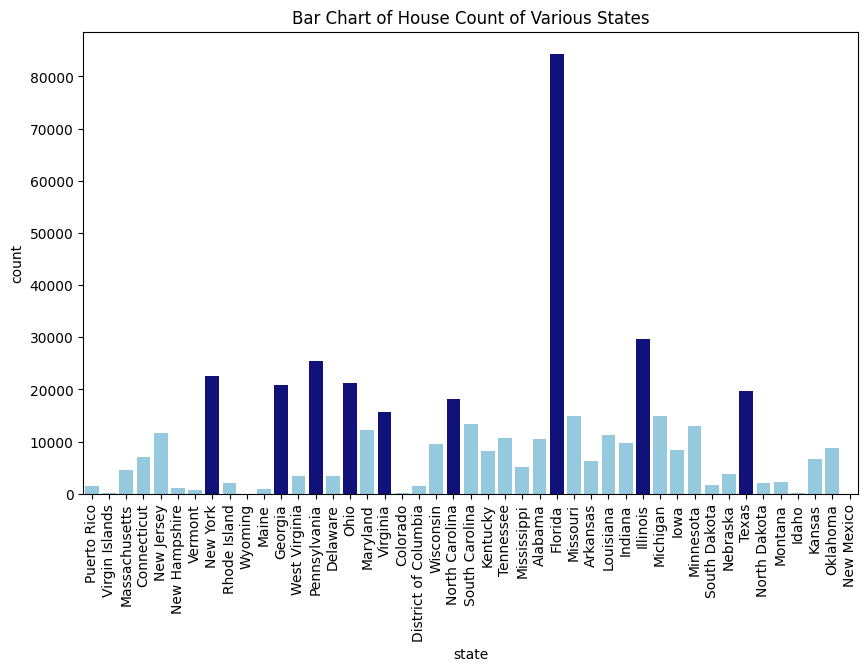

In [29]:
categorical_column = 'state'
value_counts = df[categorical_column].value_counts(sort = False)

plt.figure(figsize=(10, 6))
cols = ['skyblue' if x<15000 else 'darkblue' for x in value_counts.values]
sns.countplot(x=categorical_column, data=df, palette=cols)
plt.xticks(rotation=90)
plt.title('Bar Chart of House Count of Various States')
plt.show()

The code below shows categorization of states into 5 categories : The top 4 states with the highest number of listings (**Pennsylvania**, **New York**, **Virginia**, **North Carolina**) and **other states** in order to visualise the state variable.

In [30]:
df["grouped_states"] = [i if i == "North Carolina" or i == "Pennsylvania" or i == "New York" or i == "Virginia" else "Other States" for i in df.state]

**'Bed'** and **'Bath'** variables represent the rooms of a house, so we can combine them into a single variable and compare them with other variables.

In [31]:
df["bed_bath"] = df.bed + df.bath


### Comparison of Price and Living Areas for Various States

---

From the visualisation below, it is observed that **Virginia** is the state where the price increases the most as the size of the house increases by a unit. Conversely, **New York** has the smallest change of price with a unit change of house size.

The steepest gradient is for hue 'Pennsylvania', with a slope of 170.18


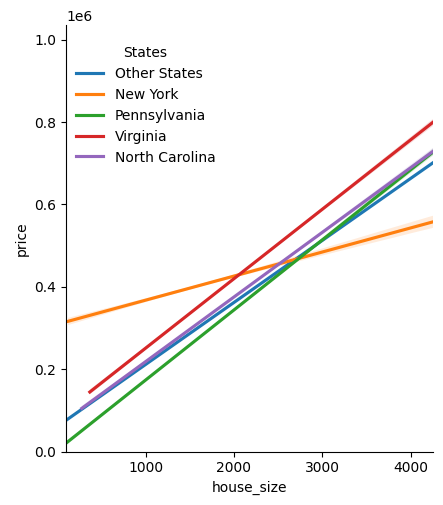

In [32]:
g = sns.lmplot(x="house_size", y="price", hue="grouped_states", data=df, scatter_kws={'alpha': 1}, scatter=False)
plt.xlim(df['house_size'].min(), df['house_size'].max())
plt.ylim(df['price'].min(), df['price'].max())
g._legend.set_title("States")
g._legend.set_bbox_to_anchor((.35, 0.8))

regression_lines = g.ax.get_lines()

slopes = {}

for line in regression_lines:
    x_data = line.get_xdata()
    y_data = line.get_ydata()
    
    slope, _ = np.polyfit(x_data, y_data, 1)
    
    slopes[line.get_label()] = slope

steepest_hue = max(slopes, key=slopes.get)
steepest_slope = slopes[steepest_hue]

print("The steepest gradient is for hue '{}', with a slope of {:.2f}".format(steepest_hue, steepest_slope))

plt.show()

### Comparison of Price with Room Numbers for Various States

---

It can be observed that almost all of the states have a uniform distribution of total room quantity. However, **Virginia** has the steepest gradient compared to others, which means for an increase of one unit room (whether bathroom or bedroom), the price increment is much higher compared to other states.

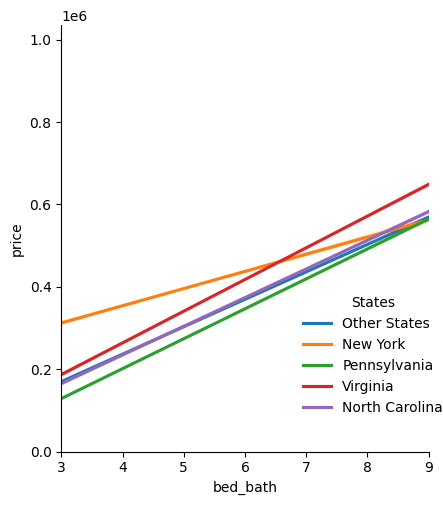

In [33]:
g=sns.lmplot(x="bed_bath",y="price",hue="grouped_states",data=df,scatter_kws={'alpha':1},scatter=False);
plt.xlim(df['bed_bath'].min(), df['bed_bath'].max())
plt.ylim(df['price'].min(), df['price'].max())
g._legend.set_title("States")
g._legend.set_bbox_to_anchor((.7, 0.3))

### Price Densities by States

---

From the visualisation, it is observed that homes in **New York** have a wide range of prices, whilst homes in **North Carolina** and **Pennsylvania** generally have similar prices, with both measured with the area under their respective curves.

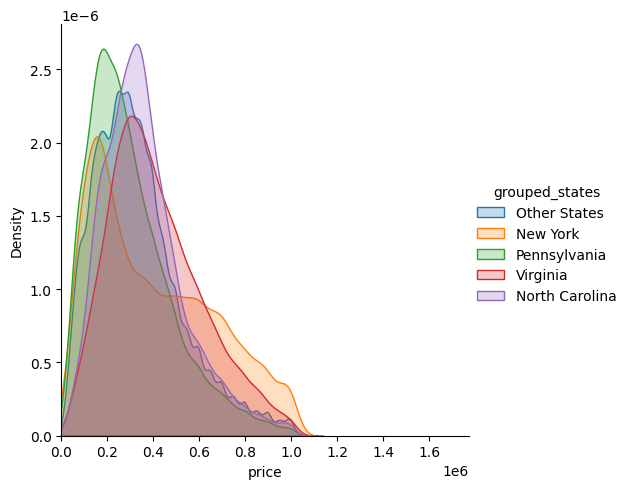

In [34]:
(sns
 .FacetGrid(df,hue="grouped_states",height=5,xlim=(0,11**6))
 .map(sns.kdeplot,"price",fill=True)
 .add_legend()
);

### Heatmap of Bed and Bath

---

The visualisation shows that a house with **3 bedrooms** and **2 bathrooms** is the most common configuration, with a count of **36.522k**.

In [35]:
fig = px.density_heatmap(df, x="bed", y="bath",marginal_x="histogram", marginal_y="histogram",width=500,height=500)

fig.update_layout(yaxis_range=[1,5],xaxis_range=[1,5],title="Heatmap of Bed and Bath")
fig.show()

### Distribution of Acre Lot

---

The **'acre_lot'** variable represents the ratio of house to land in a listing. The fact that its maximum value is significantly higher than the median value shows that the majority of the listings are single apartments or detached houses. **[NOTE : The visually minimum point of the violin plot, where it extends to value < 0, is normal. It is a Kernel Density Estimation, which extrapolates the data. This is the default configuration of the library.]**

In [36]:
fig = px.violin(df, y="acre_lot",width=500)
fig.update_traces(points=False)
fig.update_layout(title = "Violin Plot of Distribution Acre Lot ")
fig.show()

### Scatter Plot of Average Price against Acre Lot

---

The visualisation shows that generally the price increases with an increase in acre lot, following the trend line. However, there are some outliers, which may be attributed to the vibrancy of the state they are located at.

In [37]:
df_mean = df.groupby('acre_lot')['price'].mean().reset_index()

fig = px.scatter(df_mean, x='acre_lot', y='price', trendline='ols')
fig.update_layout(title='Scatter Plot of Average Price against Acre Lot', xaxis_title='Acre Lot', yaxis_title='Price')

fig.update_layout(width=800)  

fig.show()

### Top 10 States with Highest Average House Size

---

The visualisation below shows that Colarado has the highest average house size of 2376 sqft.

In [38]:
df_mean = df.groupby('state')['house_size'].mean().reset_index()

df_mean_sort = df_mean.sort_values(by='house_size', ascending=False)
top10_states = df_mean_sort.head(10)

# Plot the vertical bar chart
fig = px.bar(top10_states, x='state', y='house_size', color='state')
fig.update_layout(
    title='Top 10 States with Highest Average House Size',
    xaxis_title='State',
    yaxis_title='Average House Size (sqft)',
    width=800,  # Adjust the width
    height=600  # Adjust the height
)
fig.update_traces(texttemplate='%{y:.1f}', textposition='outside')
fig.show()


### Distribution of House Prices

---

This visualisation shows the distribution of house prices.

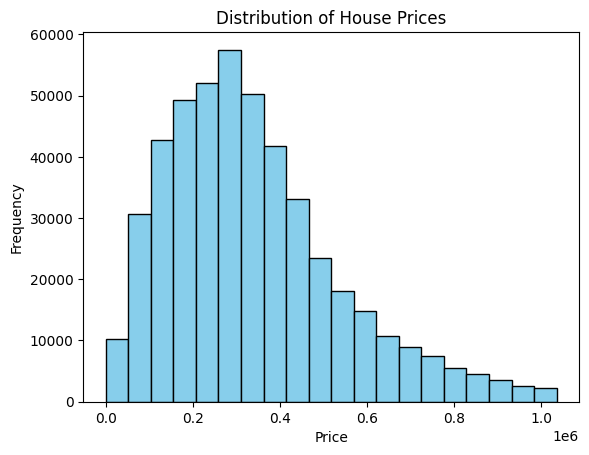

In [39]:
plt.hist(df['price'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Distribution of House Prices')
plt.show()

### Box Plot of House Size by Bedrooms

---

This visualisation shows a box plot illustrating the distribution of house sizes across different numbers of bedrooms, allowing for a comparative analysis of house size variation with respect to the number of bedrooms.

C:\Users\OEM\AppData\Local\Temp\ipykernel_14072\3292087680.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




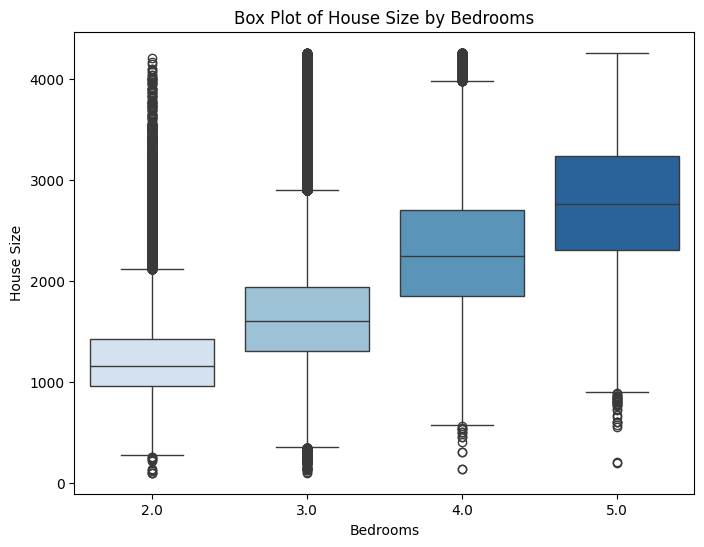

In [40]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='bed', y='house_size', data=df, palette='Blues')
plt.xlabel('Bedrooms')
plt.ylabel('House Size')
plt.title('Box Plot of House Size by Bedrooms')
plt.show()

### Histogram of Acre Lot vs Bedrooms

---

This visualisation shows the relationship between the size of acre lots and the number of bedrooms in houses, with the intensity of color indicating the frequency of occurrences.

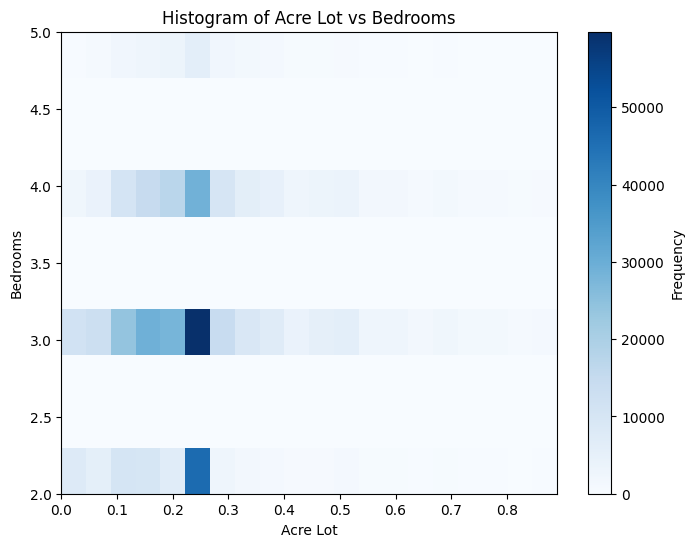

In [41]:
plt.figure(figsize=(8, 6))
plt.hist2d(df['acre_lot'], df['bed'], bins=(20, 10), cmap='Blues')
plt.colorbar(label='Frequency')
plt.xlabel('Acre Lot')
plt.ylabel('Bedrooms')
plt.title('Histogram of Acre Lot vs Bedrooms')
plt.show()